# **Imports**

In [1]:
import os as osx
# Provides a portable way of using operating system dependent functionality such as file path handling, directory creation, etc.

import json
# Used for parsing and writing JSON files — essential for saving/loading model metadata or configs.

from IPython.display import display, FileLink
# Enables creating clickable links for downloading files directly from notebook outputs.

import kagglehub
# Utility for downloading pre-trained models or datasets from Kaggle ModelHub in a programmatic way.

import numpy as npx
# Fundamental package for numerical computations, array manipulations, and linear algebra operations.

import pandas as pdx
# Powerful data analysis and manipulation library — ideal for handling CSVs and DataFrames.

import random as randomx
# Useful for generating random numbers, shuffling data, setting seeds, etc.

from sklearn.metrics import accuracy_score as accx
# Evaluates the ratio of correctly predicted labels to total predictions.

from sklearn.metrics import f1_score as f1sx
# Computes the F1 score, which balances precision and recall — especially useful for imbalanced classes.

from sklearn.metrics import precision_score as psx
# Measures the accuracy of positive predictions (how many selected items are relevant).

from sklearn.metrics import recall_score as rsx
# Measures the ability of a classifier to find all the positive samples.

from sklearn.metrics import cohen_kappa_score as cksx
# Evaluates inter-annotator agreement — helpful when comparing two raters or predictions.

from sklearn.metrics import classification_report as crx
# Generates a text summary of precision, recall, F1-score, and support per class.

from sklearn.metrics import confusion_matrix as cmx
# Displays the number of true/false positives and negatives — great for classification error analysis.

from sklearn.metrics import roc_auc_score as rocx
# Computes the Area Under the Receiver Operating Characteristic Curve — helpful for binary classification.

from sklearn.metrics import roc_curve as roccx
# Returns the ROC curve data — false positive rate, true positive rate, thresholds.

import math
# Includes mathematical functions like square root, exponential, logarithm, etc.

import seaborn as snsx
# A data visualization library based on matplotlib — great for making statistical plots like heatmaps.

from tqdm import tqdm
# Adds a smart progress bar to loops — especially useful during training or preprocessing.

import plotly.express as pxx
# High-level interactive visualization library — good for dynamic and publication-ready plots.

import matplotlib.pyplot as pltx
# Basic plotting library in Python — widely used for quick and customizable visualizations.

from PIL import Image as Img
# Python Imaging Library — used for opening, manipulating, and converting images.

from sklearn.preprocessing import label_binarize
# Converts class labels into a binary format — often needed for multi-class ROC/AUC or one-vs-rest classifiers.

import tensorflow as tfx
# Deep learning framework developed by Google — used to build and train neural networks.

from tensorflow import keras as kx
# High-level neural network API in TensorFlow — simplifies model definition and training.

from tensorflow.keras.preprocessing import image as imgs
# Image preprocessing utilities — loading, resizing, converting images to arrays.

from tensorflow.keras import callbacks as cbx, layers as lx, Model as mdl
# Essential model components — callbacks for training control, layers for model architecture, base model class.

from tensorflow.keras.preprocessing.image import ImageDataGenerator as idg
# Real-time data augmentation tool — generates batches of augmented image data during training.

from tensorflow.keras.callbacks import EarlyStopping as esx, ReduceLROnPlateau as rlrpx, ModelCheckpoint as mcpx
# Individual training callbacks — stop early if performance stalls, reduce LR, or save best model weights.

%matplotlib inline
# Jupyter-specific magic command to display matplotlib plots inline within the notebook.
from sklearn.utils.class_weight import compute_class_weight as cmpute_clss_wght

import warnings  # To filter or ignore warnings

from tensorflow.keras.layers import (
    Input, GlobalAveragePooling2D, concatenate,
    BatchNormalization, Dense, LeakyReLU, Dropout
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy as catcrsstrpy
from tensorflow.keras.applications import ResNet50, DenseNet121
from matplotlib.patches import Patch

2025-07-08 05:39:42.789048: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1751953183.018938      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1751953183.086335      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# **Dataset**

In [2]:
vipool_nw_plnt_diseases_dtst_pth = kagglehub.dataset_download('vipoooool/new-plant-diseases-dataset')
# Downloads the "New Plant Diseases Dataset" from Kaggle ModelHub using the dataset ID and stores the local path in a variable.

print('Data source import complete.')
# Confirms that the dataset has been successfully downloaded and is ready for use.

Data source import complete.


# **Config**

In [3]:
class config:
    # Batch size for training data
    trn_btch_sze = 64  # Defines how many samples per training batch
    
    # Batch size for test/validation data
    tst_btch_sze = 32  # Defines how many samples per validation/test batch

    # Path to the best saved DenseNet model (.h5 format)
    bst_dnet_mdl = '/kaggle/input/densenet/tensorflow2/default/1/best_densenet_model.h5'  # Used for inference or to resume training

    # Path to class/category mapping used during training
    dnet_categories = '/kaggle/input/densenet/tensorflow2/default/1/dnet_categories.json'  # Contains label-index mapping

    # Path to the full DenseNet model (in Keras format)
    dnet_mdl = '/kaggle/input/densenet/tensorflow2/default/1/dnet_plant_disease.keras'  # Full model architecture and weights

    # Path to the training history (e.g., loss/accuracy per epoch)
    dnet_hisx = '/kaggle/input/densenet/tensorflow2/default/1/dnet_history.json'  # Used to plot or resume training history

    # Flag to enable or skip training
    enble_trning = False  # If False, model will not retrain and instead use the saved one
    
    # Path to class/category mapping used during training
    hybrid_categries = '/kaggle/input/leaf_hybird_model/tensorflow2/default/1/hybrid_categories.json'  # Contains label-index mapping

    # Path to the full DenseNet model (in Keras format)
    hybrid_mdl = '/kaggle/input/leaf_hybird_model/tensorflow2/default/1/hybrid_plant_disease.keras'  # Full model architecture and weights

    # Path to the training history (e.g., loss/accuracy per epoch)
    hybrid_historyx = '/kaggle/input/leaf_hybird_model/tensorflow2/default/1/hybrid_history.json'  # Used to plot or resume training history

    # Flag to enable or skip training
    hybrid_enble_trning = False 
    
    hybrid_epochs=15

    # Root directory for the plant disease dataset (Augmented)
    dtst_root = "/kaggle/input/new-plant-diseases-dataset/new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)"  # Base dataset directory

    # Directory containing training data
    trn_dir = osx.path.join(dtst_root, "train")  # Path to training images

    # Directory containing validation/test data
    tst_dir = osx.path.join(dtst_root, "valid")  # Path to validation images

    # Directory containing real-time test images
    rl_timex_dir = '/kaggle/input/new-plant-diseases-dataset/test/test'  # Path to test set for real-time evaluation

    # Total number of training epochs
    epochs = 15  # Number of full passes through the training dataset

    rsnt_enble_trning=False
    rsnt_mdl='/kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_plant_disease.keras'
    rsnt_hisx='/kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_history.json'
    rsnt_categories='/kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_categories.json'
    

# **Augmentation**

For Training 

In [4]:
# Define image size to which all input images will be resized
img_sze = 224  # Input image dimensions (224x224)

# Define augmentation strategies for training dataset
trn_aug = idg(
    rescale=1/255.0,  # Normalize pixel values from [0, 255] to [0, 1]
    fill_mode="nearest",  # Fill missing pixels after shift with nearest pixel values
    width_shift_range=0.2,  # Randomly shift image horizontally by up to 20%
    height_shift_range=0.2,  # Randomly shift image vertically by up to 20%
    zoom_range=0.2,  # Randomly zoom in/out by up to 20%
    shear_range=0.2  # Randomly shear image to simulate slanting (distortion)
)

# Load images from the training directory using the augmentation generator
trn_dta = trn_aug.flow_from_directory(
    config.trn_dir,  # Path to the training image directory
    target_size=(img_sze, img_sze),  # Resize all images to (224x224)
    batch_size=config.trn_btch_sze,  # Number of images per training batch
    class_mode="categorical"  # One-hot encode labels for multi-class classification
)

Found 70295 images belonging to 38 classes.


In [5]:
# Define a shared ImageDataGenerator with both augmentation and validation split
dta_aug = idg(
    rescale=1/255.0,            # Normalize pixel values to the [0, 1] range
    fill_mode="nearest",        # Fill in missing pixels from shifting using nearest pixel strategy
    width_shift_range=0.2,      # Randomly shift images horizontally by up to 20%
    height_shift_range=0.2,     # Randomly shift images vertically by up to 20%
    zoom_range=0.2,             # Random zoom in/out by up to 20%
    shear_range=0.2,            # Apply shear transformations (distortion/tilt effect)
    validation_split=0.5        # Reserve 50% of data for validation from the same directory
)

# Load 50% of the images as "training" data from the validation directory
tst_dta = dta_aug.flow_from_directory(
    config.tst_dir,             # Path to the validation directory
    target_size=(img_sze, img_sze),  # Resize all images to (224x224)
    batch_size=config.tst_btch_sze,  # Number of images per batch
    class_mode="categorical",   # One-hot encoded label format for multi-class classification
    subset='training',          # Use the training split of the 50% validation data
    shuffle=False,              # Do not shuffle — helpful for reproducibility or visualization
    seed=42                     # Fixed seed ensures consistent split each time
)

# Load the remaining 50% of images as "validation" data
val_dta = dta_aug.flow_from_directory(
    config.tst_dir,             # Same directory used — split internally by `validation_split`
    target_size=(img_sze, img_sze),  # Resize to the same shape as training images
    batch_size=config.tst_btch_sze,  # Number of images per batch
    class_mode="categorical",   # One-hot encoded labels
    subset='validation',        # Use the validation split of the dataset
    shuffle=False,              # Do not shuffle — ensures labels and order remain consistent
    seed=42                     # Same seed used to make sure both subsets are complementary
)


Found 8795 images belonging to 38 classes.
Found 8777 images belonging to 38 classes.


# **Exploratory Data Analysis**

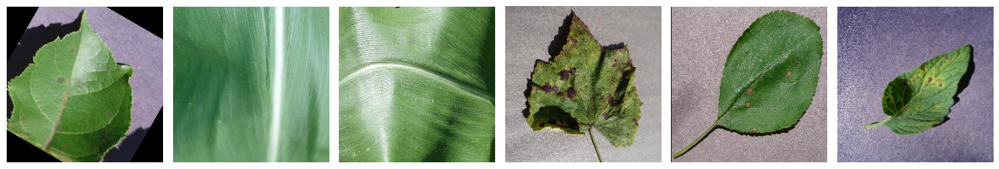

In [6]:
# Path to the training directory
trn_img_dir = config.trn_dir  # Get the path to the training image folder from the config

# Initialize an empty list to store all training image file paths
all_trn_imgs = []

# Loop through each class folder in the training directory
for clss_fldr in osx.listdir(trn_img_dir):
    clss_pth = osx.path.join(trn_img_dir, clss_fldr)  # Construct full path to the class folder
    
    if osx.path.isdir(clss_pth):  # Check if it's a valid directory (not a file)
        for fname in osx.listdir(clss_pth):  # Loop through all files in the class folder
            if fname.lower().endswith(('.png', '.jpg', '.jpeg')):  # Filter only image files
                all_trn_imgs.append(osx.path.join(clss_pth, fname))  # Store full path to the image

# Randomly select 6 image paths from the full list
randomx_imgs = randomx.sample(all_trn_imgs, 6)  # Randomly pick 6 images for display

# Create a figure for displaying the images side by side
pltx.figure(figsize=(15, 5))  # Set the overall figure size (15 inches wide, 5 inches tall)

# Loop through the selected images and plot them
for i, img_pth in enumerate(randomx_imgs):
    img = Img.open(img_pth).convert('RGB')  # Open the image and convert to RGB format

    pltx.subplot(1, 6, i + 1)  # Create a 1-row, 6-column subplot and select the i-th plot
    pltx.imshow(img)  # Display the image
    pltx.axis('off')  # Hide axis ticks and labels for a cleaner view

pltx.tight_layout()  # Adjust spacing between plots to avoid overlap
pltx.show()  # Display the final set of images


I0000 00:00:1751953221.208680      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1751953221.209367      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


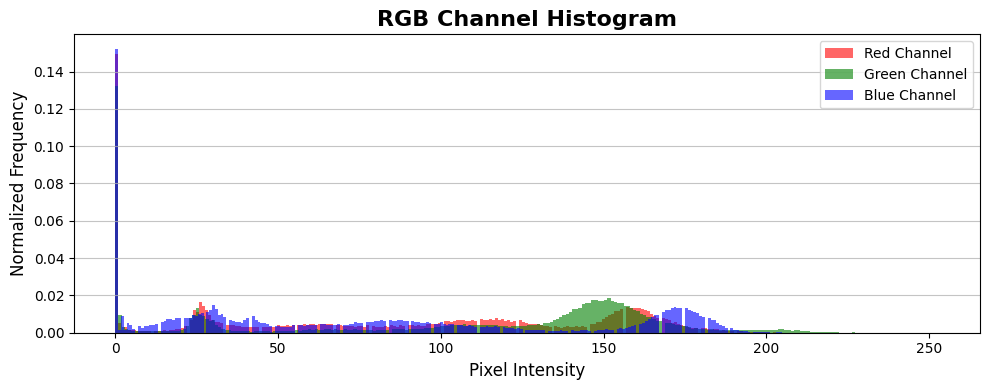

In [7]:
def plt_rgb_histogrm_tnsorflow(img_pth):
    """
    Plots an aesthetically pleasing RGB histogram using TensorFlow and Matplotlib.

    Args:
        img_pth (str): Path to the image file.
    """
    try:
        # Read image file as raw bytes using TensorFlow
        img_raw = tfx.io.read_file(img_pth)  # Load image as raw bytes from the path

        # Decode the raw image bytes into a 3-channel (RGB) tensor
        img_tnsor = tfx.image.decode_image(img_raw, channels=3)

        # Convert image tensor to float32 type with pixel values in [0, 1]
        img_tnsor = tfx.image.convert_image_dtype(img_tnsor, tfx.float32)

        # Convert TensorFlow tensor to NumPy array for processing with matplotlib
        img_rray = img_tnsor.numpy()

        # Scale back to [0, 255] for visualization, and convert to unsigned 8-bit integers
        img_rray = (img_rray * 255).astype(npx.uint8)

        # Flatten each channel (Red, Green, Blue) to 1D arrays
        r_chnnel = img_rray[:, :, 0].flatten()  # Red channel
        g_chnnel = img_rray[:, :, 1].flatten()  # Green channel
        b_chnnel = img_rray[:, :, 2].flatten()  # Blue channel

        # Start plotting the histograms
        pltx.figure(figsize=(10, 4))  # Create a wide figure

        # Plot Red channel histogram
        pltx.hist(r_chnnel, bins=256, color='red', alpha=0.6, label='Red Channel', density=True)

        # Plot Green channel histogram
        pltx.hist(g_chnnel, bins=256, color='green', alpha=0.6, label='Green Channel', density=True)

        # Plot Blue channel histogram
        pltx.hist(b_chnnel, bins=256, color='blue', alpha=0.6, label='Blue Channel', density=True)

        # Add plot title and axis labels
        pltx.title('RGB Channel Histogram', fontsize=16, fontweight='bold')
        pltx.xlabel('Pixel Intensity', fontsize=12)  # X-axis: Intensity values
        pltx.ylabel('Normalized Frequency', fontsize=12)  # Y-axis: Frequency of pixel values

        # Show legend and grid
        pltx.legend()  # Show channel labels
        pltx.grid(axis='y', alpha=0.75)  # Add a grid for the Y-axis

        # Tight layout for better spacing
        pltx.tight_layout()

        # Display the plot
        pltx.show()

    # Handle case where image path is not found
    except tfx.errors.NotFoundError:
        print(f"Error: Image file not found at {image_path}")

    # Catch all other potential errors
    except Exception as e:
        print(f"An error occurred: {e}")

# If random images were selected earlier, plot histogram of the first one
if randomx_imgs:
    plt_rgb_histogrm_tnsorflow(randomx_imgs[0])  # Plot RGB histogram for the first random image

# If no random images available, notify the user
else:
    print("No random images selected. Please run the previous cell to select images.")


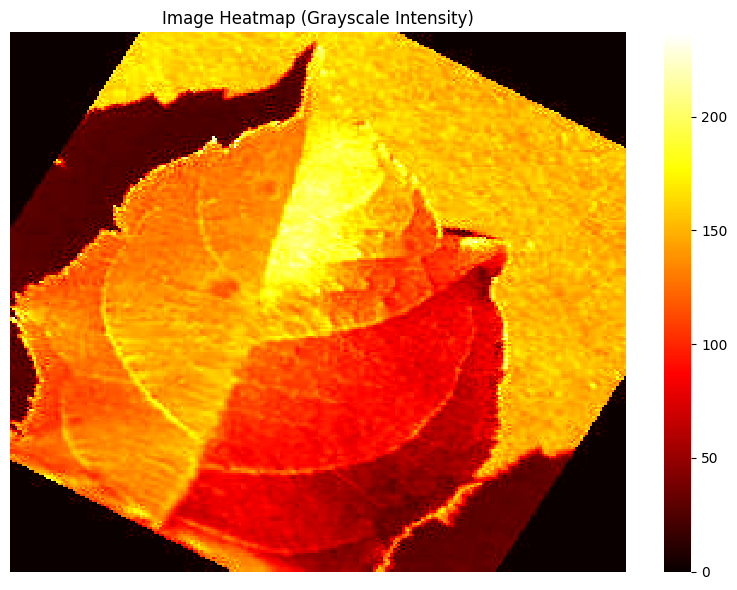

In [8]:
def plt_heatmap_of_img_tnsorflow(img_pth):
    """
    Plots a heatmap of an image's grayscale intensity using TensorFlow.

    Args:
        img_pth (str): Path to the image file.
    """
    try:
        # Read image using TensorFlow and convert to grayscale
        img_raw = tfx.io.read_file(img_pth)
        img_tnsor = tfx.image.decode_image(img_raw, channels=1)  # Grayscale (1 channel)
        img_tnsor = tfx.image.convert_image_dtype(img_tnsor, tfx.float32)  # Normalize to [0, 1]

        # Convert to numpy array and scale to 0–255 for better contrast in heatmap
        img_rray = (img_tnsor.numpy().squeeze() * 255).astype(npx.uint8)

        # Plot the heatmap
        pltx.figure(figsize=(8, 6))
        snsx.heatmap(img_rray, cmap='hot', cbar=True)
        pltx.title('Image Heatmap (Grayscale Intensity)')
        pltx.axis('off')
        pltx.tight_layout()
        pltx.show()

    except tfx.errors.NotFoundError:
        print(f"Error: Image file not found at {img_pth}")
    except Exception as e:
        print(f"An error occurred: {e}")

# Example usage
if randomx_imgs:
    plt_heatmap_of_img_tnsorflow(randomx_imgs[0])
else:
    print("No random images selected. Please run the previous cell to select images.")

In [9]:
# === Parse class name into plant and disease ===
def prse_clss_nme(clss_nme):
    plnt, diseasex = clss_nme.split('___')
    return plnt, diseasex.replace('_', ' ')

# === Count samples from generator ===
def cnt_clss_smpls(gnrtr):
    cnts = dict.fromkeys(gnrtr.class_indices.keys(), 0)
    for idx in gnrtr.classes:
        clss_nme = list(gnrtr.class_indices.keys())[list(gnrtr.class_indices.values()).index(idx)]
        cnts[clss_nme] += 1
    return cnts

# === Count samples in both training and validation sets ===
trn_cnts = cnt_clss_smpls(tst_dta)
val_cnts = cnt_clss_smpls(val_dta)

# === Combine counts ===
totl_cnts = {
    cls: trn_cnts.get(cls, 0) + val_cnts.get(cls, 0)
    for cls in trn_cnts.keys()
}

# === Prepare sunburst data ===
snbrst_dta = []
totl_imgs = sum(totl_cnts.values())

for cls, cnt in totl_cnts.items():
    plnt, diseasex = prse_clss_nme(cls)
    prcntge = (cnt / totl_imgs) * 100
    snbrst_dta.append({
        'Plant': plnt,
        'Disease': diseasex,
        'Count': cnt,
        'Percentage': prcntge
    })

dfx = pdx.DataFrame(snbrst_dta)

# === Sunburst plot ===
figx = pxx.sunburst(
    dfx,
    path=['Plant', 'Disease'],
    values='Percentage',
    title='Distribution of Plant Species and Diseases',
    color='Percentage',
    color_continuous_scale='Tealgrn'
)

figx.update_traces(
    textinfo='label+percent entry',
    hovertemplate='<b>%{label}</b><br>Percentage: %{value:.2f}%<br>Count: %{customdata[0]}',
    customdata=dfx[['Count']].values
)

figx.update_layout(
    margin=dict(t=50, l=50, r=50, b=50)
)

figx.show()


# **Helper Function**

In [10]:
def eval_mdl(y_true, y_pred, y_prob=None, class_names=None, label="Evaluation", normalize=False, figsize=(24, 20), fontsize=6):
    """
    Evaluate classification metrics, ROC curve, and confusion matrix.
    
    Args:
        y_true     : Ground truth class indices.
        y_pred     : Predicted class indices.
        y_prob     : Predicted probabilities (for ROC curve).
        class_names: List of class names.
        label      : Label for context.
        normalize  : Normalize confusion matrix.
        figsize    : Size of confusion matrix plot.
        fontsize   : Font size for annotations.
    """

    # === Classification Metrics ===
    acc    = accx(y_true, y_pred)                    # Calculate overall accuracy
    f1     = f1sx(y_true, y_pred, average='weighted')# Calculate weighted F1 score
    prec   = psx(y_true, y_pred, average='weighted') # Calculate weighted precision
    recall = rsx(y_true, y_pred, average='weighted') # Calculate weighted recall
    kappa  = cksx(y_true, y_pred)                    # Calculate Cohen’s Kappa score

    # Print classification metric results
    print(f"\n{label} Metrics:")
    print(f"Accuracy            : {acc :.4f}")
    print(f"F1 Score (Weighted) : {f1:.4f}")
    print(f"Precision           : {prec:.4f}")
    print(f"Recall              : {recall:.4f}")
    print(f"Cohen's Kappa       : {kappa:.4f}")

    # === Classification Report ===
    if class_names:
        print(f"\n{label} Classification Report:\n")
        print(crx(y_true, y_pred, target_names=class_names))  # Report with class names
    else:
        print(f"\n{label} Classification Report:\n")
        print(crx(y_true, y_pred))  # Report without class names

    # === Average ROC Curve ===
    if y_prob is not None:
        num_classes = npx.unique(y_true).shape[0]                   # Get number of classes
        y_true_bin = label_binarize(y_true, classes=npx.arange(num_classes))  # One-hot encode y_true

        try:
            # Initialize dictionaries to store FPR, TPR, and AUC for each class
            fpr, tpr, roc_auc = dict(), dict(), dict()

            # Compute FPR, TPR, AUC for each class
            for i in range(num_classes):
                fpr[i], tpr[i], _ = roccx(y_true_bin[:, i], y_prob[:, i])  # ROC curve
                roc_auc[i] = rocx(y_true_bin[:, i], y_prob[:, i])          # AUC

            # Compute macro-average ROC curve
            all_fpr = npx.unique(npx.concatenate([fpr[i] for i in range(num_classes)]))  # Combine all FPR points
            mean_tpr = npx.zeros_like(all_fpr)  # Placeholder for mean TPR

            for i in range(num_classes):
                mean_tpr += npx.interp(all_fpr, fpr[i], tpr[i])  # Interpolate TPRs

            mean_tpr /= num_classes  # Average over classes
            macro_auc = rocx(y_true_bin, y_prob, average='macro', multi_class='ovr')  # Compute macro AUC

            # === Plot ROC Curve ===
            pltx.figure(figsize=(8, 6))
            pltx.plot(all_fpr, mean_tpr, color='navy',
                      label=f'Macro-average ROC (AUC = {macro_auc:.4f})', linewidth=2)  # Macro ROC line
            pltx.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Diagonal reference
            pltx.xlim([0.0, 1.0])
            pltx.ylim([0.0, 1.05])
            pltx.xlabel('False Positive Rate')
            pltx.ylabel('True Positive Rate')
            pltx.title(f'{label} Macro-average ROC Curve')
            pltx.legend(loc="lower right")
            pltx.grid(True)
            pltx.tight_layout()
            pltx.show()

        except Exception as e:
            # Handle any exceptions during ROC plotting
            print("\nCould not compute or plot ROC AUC Curve:", str(e))

    # === Confusion Matrix ===
    print("Plotting Confusion matrix:")
    cm = cmx(y_true, y_pred, normalize='true' if normalize else None)  # Compute confusion matrix

    pltx.figure(figsize=figsize)  # Set figure size
    snsx.heatmap(
        cm,
        annot=True,                          # Show numbers in cells
        fmt=".2f" if normalize else "d",     # Format based on normalization
        cmap="Blues",                        # Color map
        xticklabels=class_names if class_names else "auto",  # X-axis labels
        yticklabels=class_names if class_names else "auto",  # Y-axis labels
        square=True,                         # Square cells
        cbar_kws={"shrink": 0.5},            # Color bar config
        annot_kws={"size": fontsize}         # Font size for annotations
    )

    # Axis titles and formatting
    pltx.title("Normalized Confusion Matrix" if normalize else "Confusion Matrix", fontsize=18)
    pltx.xlabel("Predicted Labels", fontsize=12)
    pltx.ylabel("True Labels", fontsize=12)
    pltx.xticks(rotation=90, fontsize=8)  # Rotate x-axis labels
    pltx.yticks(rotation=0, fontsize=8)   # Keep y-axis labels straight
    pltx.tight_layout()
    pltx.show()


To plot the loss and accuracy curve

In [11]:
def plt_acc_and_lss_crvs(hisx):
    def smooth_curve(points, factor=0.8):
        smoothed = []
        for point in points:
            if smoothed:
                smoothed.append(smoothed[-1] * factor + point * (1 - factor))
            else:
                smoothed.append(point)
        return smoothed

    def get_axis_range(values, step):
        min_val = min(values)
        max_val = max(values)
        lower = npx.floor(min_val / step) * step
        upper = npx.ceil(max_val / step) * step
        return lower, upper, npx.arange(lower, upper + step, step)

    # Load history
    if isinstance(hisx, str):
        if osx.path.exists(hisx):
            print(f"[INFO] Loading history from: {hisx}")
            with open(hisx, 'r') as f:
                hist = json.load(f)
        else:
            raise FileNotFoundError(f"File '{hisx}' not found.")
    else:
        hist = hisx.history if hasattr(hisx, 'history') else hisx

    # Extract
    acc = hist['accuracy']
    val_acc = hist['val_accuracy']
    loss = hist['loss']
    val_loss = hist['val_loss']
    epochs = list(range(1, len(acc) + 1))

    # Smooth
    acc_smooth = smooth_curve(acc)
    val_acc_smooth = smooth_curve(val_acc)
    loss_smooth = smooth_curve(loss)
    val_loss_smooth = smooth_curve(val_loss)

    # Min-Max scale loss
    min_l = min(loss_smooth + val_loss_smooth)
    max_l = max(loss_smooth + val_loss_smooth)
    loss_scaled = [(l - min_l) / (max_l - min_l) for l in loss_smooth]
    val_loss_scaled = [(l - min_l) / (max_l - min_l) for l in val_loss_smooth]

    # Accuracy range
    acc_all = acc_smooth + val_acc_smooth
    acc_min, acc_max, acc_ticks = get_axis_range(acc_all, step=0.02)

    # Styling
    pltx.style.use('seaborn-whitegrid')
    pltx.rcParams.update({
        'font.size': 12,
        'axes.labelweight': 'bold',
        'axes.edgecolor': '#333333',
        'axes.linewidth': 1.2,
        'axes.titlesize': 15,
        'axes.titleweight': 'bold',
        'legend.frameon': True,
        'legend.facecolor': 'white',
        'legend.edgecolor': 'gray'
    })

    fig, (ax1, ax2) = pltx.subplots(1, 2, figsize=(14, 6))
    train_color = '#4c72b0'
    val_color = '#dd8452'

    # Accuracy Plot
    ax1.plot(epochs, acc_smooth, 'o-', label='Train Accuracy', color=train_color, linewidth=2)
    ax1.plot(epochs, val_acc_smooth, 's--', label='Validation Accuracy', color=val_color, linewidth=2)
    ax1.fill_between(epochs, acc_smooth, val_acc_smooth, color='#b0cbe8', alpha=0.15)
    ax1.set_title('Accuracy Over Epochs')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Accuracy')
    ax1.set_xticks(epochs)
    ax1.set_yticks(acc_ticks)
    ax1.set_ylim(acc_min, acc_max)
    ax1.legend(loc='lower right')
    ax1.grid(True, linestyle='--', alpha=0.5)

    # Scaled Loss Plot
    ax2.plot(epochs, loss_scaled, 'o-', label='Train Loss (scaled)', color=train_color, linewidth=2)
    ax2.plot(epochs, val_loss_scaled, 's--', label='Validation Loss (scaled)', color=val_color, linewidth=2)
    ax2.fill_between(epochs, loss_scaled, val_loss_scaled, color='#f9c79f', alpha=0.15)
    ax2.set_title('Loss Over Epochs (Scaled)')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Loss (Min-Max Scaled)')
    ax2.set_xticks(epochs)
    ax2.set_ylim(0, 1)
    ax2.legend(loc='upper right')
    ax2.grid(True, linestyle='--', alpha=0.5)

    pltx.subplots_adjust(wspace=0.3)
    pltx.tight_layout()
    pltx.show()


Inference: It prints the images from real_time dir which contains 33 images  

In [12]:
def predict_and_show_images(
    model,
    img_pths,
    class_indices,
    target_size=(224, 224),
    true_labels=None,
    imgs_per_row=6
):
    """
    Predicts and displays images with predicted class, actual label (if given), and prediction confidence.

    Parameters:
    - model: Keras model used for making predictions
    - img_pths: list of paths to image files
    - class_indices: dictionary like {'cat': 0, 'dog': 1} (used to reverse map index to label)
    - target_size: expected input size for model (default 224x224)
    - true_labels: optional list of actual class names for ground truth comparison
    - imgs_per_row: how many images to show per row in the plot
    """

    # Convert class_indices to idx_to_clss (e.g., 0: 'cat', 1: 'dog') for reverse lookup
    idx_to_clss = {v: k for k, v in class_indices.items()}

    # Total number of images to display
    num_imgs = len(img_pths)

    # Compute how many rows are needed to show all images based on desired images per row
    rows = (num_imgs + imgs_per_row - 1) // imgs_per_row

    # Create a figure of appropriate size (dynamically scaled)
    pltx.figure(figsize=(imgs_per_row * 4, rows * 4))

    # Loop over each image path
    for i, img_pth in enumerate(img_pths):

        # === Step 1: Load and preprocess the image ===
        imgss = imgs.load_img(img_pth, target_size=target_size)  # Load image and resize
        x = imgs.img_to_array(imgss) / 255.0                     # Convert image to array & normalize to [0,1]
        x_exp = npx.expand_dims(x, axis=0)                       # Expand dimensions to match model input shape (1, H, W, C)

        # === Step 2: Predict using the model ===
        preds = model.predict(x_exp, verbose=0)[0]               # Run prediction (returns a list of class probs)
        pred_idx = npx.argmax(preds)                             # Get the index of the class with highest probability
        confidence = preds[pred_idx]                             # Confidence of the prediction (probability)
        pred_label = idx_to_clss.get(pred_idx, "Unknown")        # Map class index to label name

        # === Step 3: Get true label if provided ===
        if true_labels:
            true_label = true_labels[i]                          # Use provided true label
        else:
            # Infer label from file path if true_labels not given (e.g., from folder name or filename)
            true_label = osx.path.basename(img_pth)

        # === Step 4: Plot the image and its details ===
        pltx.subplot(rows, imgs_per_row, i + 1)                  # Position in the subplot grid
        pltx.imshow(x)                                           # Show the image (already normalized)
        pltx.axis('off')                                         # Hide axis lines/ticks

        # Add title with predicted label, true label, and confidence score
        title = f"Pred: {pred_label}\nTrue: {true_label}\nConf: {confidence:.2f}"
        pltx.title(title, fontsize=10)

    # === Final formatting ===
    pltx.tight_layout()  # Prevent overlap between subplots
    pltx.show()          # Display the figure


In [13]:
def get_all_images_from_folder(folder_path):
    """
    Returns a list of all image file paths in the given folder.

    Parameters:
    - folder_path: str, path to the folder containing images

    Returns:
    - list of image file paths
    """
    valid_extensions = ('.png', '.jpg', '.jpeg', '.bmp', '.gif')
    all_images = [
        osx.path.join(folder_path, f)
        for f in osx.listdir(folder_path)
        if f.lower().endswith(valid_extensions)
    ]
    return all_images


Helper Function for Comparative plot

In [14]:
def load_final_metrics(hisx):
    """Load and return final epoch values from path or Keras history."""
    if isinstance(hisx, str):
        if not osx.path.exists(hisx):
            raise FileNotFoundError(f"File '{hisx}' not found.")
        with open(hisx, 'r') as f:
            hist = json.load(f)
    else:
        hist = hisx.history if hasattr(hisx, 'history') else hisx

    return {
        'Train Accuracy': hist['accuracy'][-1],
        'Validation Accuracy': hist['val_accuracy'][-1],
        'Train Loss': hist['loss'][-1],
        'Validation Loss': hist['val_loss'][-1]
    }

def plot_comparative_4panels(model1, model3, model2, labels=('DenseNet', 'ResNet', 'Hybrid')):
    """
    2x2 subplot comparing:
    - Train Accuracy
    - Validation Accuracy
    - Train Loss
    - Validation Loss
    Across 3 models (DenseNet, ResNet, Hybrid).
    """

    # === Load metrics ===
    m1 = load_final_metrics(model1)
    m2 = load_final_metrics(model2)
    m3 = load_final_metrics(model3)

    metrics = ['Train Accuracy', 'Validation Accuracy', 'Train Loss', 'Validation Loss']
    x = npx.arange(len(labels))
    width = 0.6

    models = [m1, m2, m3]
    colors = ['#76D7C4', '#AF7AC5', '#F5B041']
    edge_colors = ['#148F77', '#6C3483', '#B9770E']

    fig, axs = pltx.subplots(2, 2, figsize=(12, 8))
    fig.suptitle('Model Performance Metrics', fontsize=18, fontweight='bold', y=1.05)

    for idx, metric in enumerate(metrics):
        row, col = divmod(idx, 2)
        ax = axs[row][col]

        values = [m[metric] for m in models]
        bars = ax.bar(x, values, width=width, color=colors, edgecolor=edge_colors, linewidth=1.3)

        ax.set_title(metric, fontsize=13, fontweight='bold')
        ax.set_xticks(x)
        ax.set_xticklabels(labels, fontsize=10, fontweight='bold', rotation=0)
        ax.set_ylim(0, max(values) * 1.15)
        ax.grid(axis='y', linestyle='--', alpha=0.3)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)

        for bar in bars:
            height = bar.get_height()
            ax.annotate(f'{height:.3f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 5),
                        textcoords="offset points",
                        ha='center', va='bottom',
                        fontsize=9, fontweight='bold', color='#333')

    pltx.tight_layout()
    pltx.subplots_adjust(top=0.88)
    pltx.show()


In [70]:
def plot_accuracy_comparison(dense, resnet, hybrid, labels=('DenseNet', 'ResNet', 'Hybrid')):
    """
    Plot a clean bar chart comparing Final Test Accuracy (%) of three models.
    - No emoji in title
    - No redundant scaling
    - Values are annotated clearly above bars
    - Y-axis from 0 to 100
    """

    # Use accuracy values as-is (already in %)
    accuracy_vals = [dense['Accuracy'], resnet['Accuracy'], hybrid['Accuracy']]
    colors = ['#76D7C4', '#AF7AC5', '#F5B041']
    edge_colors = ['#148F77', '#6C3483', '#B9770E']
    x = npx.arange(len(labels))
    width = 0.5

    fig, ax = pltx.subplots(figsize=(8, 5))
    bars = ax.bar(x, accuracy_vals, width=width, color=colors, edgecolor=edge_colors, linewidth=1.2)

    # Title and labels
    ax.set_title('Final Test Accuracy Comparison', fontsize=16, fontweight='bold', pad=10)
    ax.set_ylabel('Accuracy (%)', fontsize=12, fontweight='bold')
    ax.set_xticks(x)
    ax.set_xticklabels(labels, fontsize=11, fontweight='bold')
    ax.set_ylim(0, 100)  # Full scale from 0 to 100

    # Grid and axis styling
    ax.grid(axis='y', linestyle='--', alpha=0.3)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    # Annotate accuracy values
    for bar, val in zip(bars, accuracy_vals):
        height = bar.get_height()
        ax.annotate(f'{val:.2f}%',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 8),
                    textcoords="offset points",
                    ha='center', va='bottom',
                    fontsize=10, fontweight='bold', color='#333')

    pltx.tight_layout()
    pltx.show()


# **Training Classes**

In [16]:
cts = list(trn_dta.class_indices.keys())

# **DenseNet121**

In [17]:
# Load the base DenseNet model
input_shpe = (img_sze, img_sze, 3)
dnet = kx.applications.DenseNet121(
    weights="imagenet",
    include_top=False,
    input_shape=input_shpe
)

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


This cell defines the sturcture of teh model

In [18]:
# Freeze the base model
dnet.trainable = False

# Define the model structure
inputs = kx.Input(shape=input_shpe)
xx = dnet(inputs, training=False)
xx = tfx.keras.layers.GlobalAveragePooling2D()(xx)
xx = tfx.keras.layers.Dropout(0.2)(xx)
xx = tfx.keras.layers.Dense(len(cts), activation="softmax")(xx)
# Create the model
dnet_mdlx = mdl(inputs=inputs, outputs=xx)
dnet_mdlx.summary()



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ densenet121 (Functional)             │ (None, 7, 7, 1024)          │       7,037,504 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 1024)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 38)                  │          38,950 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,076,454 (26.99 MB)

 Trainable params: 38,950 (152.15 KB)

 Non-trainable params: 7,037,504 (26.85 MB)

Optimizer for the dnet model

In [19]:
# Compile the model
dnet_mdlx.compile(
    optimizer=kx.optimizers.Adam(learning_rate=1e-3),  # Initial LR
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

Defining the callbacks for dnet_mdl

In [20]:
# Define callbacks

# 1. Early Stopping
early_stopping_cb = cbx.EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True
)

# 2. ReduceLROnPlateau
lr_plateau_cb = cbx.ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.5,             # Reduce LR by half
    patience=2,             # Wait 2 epochs before reducing LR
    min_lr=1e-6,            # Minimum LR
    verbose=1               # Print update messages
)

# 3. Optional: ModelCheckpoint to save best model
mdl_chk_cb = cbx.ModelCheckpoint(
    "best_densenet_model.h5",
    save_best_only=True,
    monitor="val_loss",
    mode="min",
    verbose=1
)


fitting the dnet_mdl

In [21]:
# Checking if model already trained 
if not config.enble_trning:
    print(f"Pretrained model found at {config.dnet_mdl}. Skipping training.")
    dnet_mdlx = tfx.keras.models.load_model(config.bst_dnet_mdl)

    # Load existing history if available
    if osx.path.exists(config.dnet_hisx):
        with open(config.dnet_hisx, 'r') as f:
            history_dict = json.load(f)
        class DummyHistory:
            history = history_dict
        hisx = DummyHistory()
    else:
        print("No saved history found. Curves will be empty.")
        class DummyHistory:
            history = {
                'accuracy': [],
                'val_accuracy': [],
                'loss': [],
                'val_loss': []
            }
        hisx = DummyHistory()

else:
    print(" No pretrained model found. Proceeding with training...")

    # Compile before training if not done already
    dnet_mdlx.compile(
        optimizer=tfx.keras.optimizers.Adam(learning_rate=1e-3),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    # Train the model
    hisx = dnet_mdlx.fit(
        trn_dta,
        epochs=config.epochs,
        batch_size=config.trn_btch_sze,
        validation_data=val_dta,
        callbacks=[early_stopping_cb, lr_plateau_cb, mdl_chk_cb]
    )

    # Save the history for future reuse
    with open(config.dnet_hisx, 'w') as f:
        json.dump(hisx.history, f)


Pretrained model found at /kaggle/input/densenet/tensorflow2/default/1/dnet_plant_disease.keras. Skipping training.


## **DenseNet: Save and load**

Saving the model 

In [22]:
if config.enble_trning:
    dnet_mdlx.save(config.dnet_mdl)
    print(f"Model saved to {config.dnet_mdl}")
    display(FileLink(config.dnet_mdl))
else:
    print(f"Model file '{config.dnet_mdl}' already exists. Skipping save and link generation.")

Model file '/kaggle/input/densenet/tensorflow2/default/1/dnet_plant_disease.keras' already exists. Skipping save and link generation.


Saving the categories

In [23]:
# Save only if it doesn't exist
if config.enble_trning:
    with open(config.dnet_categories, "w") as file:
        json.dump(trn_dta.class_indices, file)
    print(f"Categories dumped to {config.dnet_categories}")
    display(FileLink(config.dnet_categories))
else:
    print(f"File '{config.dnet_categories}' already exists. Skipping category dump and link generation.")

File '/kaggle/input/densenet/tensorflow2/default/1/dnet_categories.json' already exists. Skipping category dump and link generation.


## **DenseNet: Validating Evaluation**

In [24]:
val_y_true = val_dta.classes  # From generator
val_y_probs = dnet_mdlx.predict(val_dta, verbose=1)
val_y_pred = npx.argmax(val_y_probs, axis=1)

# Class names (as you already have)
val_class_names = list(val_dta.class_indices.keys())

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.

I0000 00:00:1751953237.077801     118 service.cc:148] XLA service 0x7fc1ec001c80 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1751953237.079187     118 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1751953237.079215     118 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1751953238.237058     118 cuda_dnn.cc:529] Loaded cuDNN version 90300


  2/275 ━━━━━━━━━━━━━━━━━━━━ 27s 101ms/step  

I0000 00:00:1751953248.487434     118 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


275/275 ━━━━━━━━━━━━━━━━━━━━ 172s 569ms/step



DenseNet121 Validation Metrics:
Accuracy            : 0.9531
F1 Score (Weighted) : 0.9530
Precision           : 0.9536
Recall              : 0.9531
Cohen's Kappa       : 0.9518

DenseNet121 Validation Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.95      0.98      0.96       252
                                 Apple___Black_rot       0.98      0.98      0.98       248
                          Apple___Cedar_apple_rust       0.97      0.99      0.98       220
                                   Apple___healthy       0.99      0.97      0.98       251
                               Blueberry___healthy       0.98      0.99      0.98       227
          Cherry_(including_sour)___Powdery_mildew       1.00      0.98      0.99       210
                 Cherry_(including_sour)___healthy       0.99      1.00      0.99       228
Corn_(maize)___Cercospora_leaf_spot G

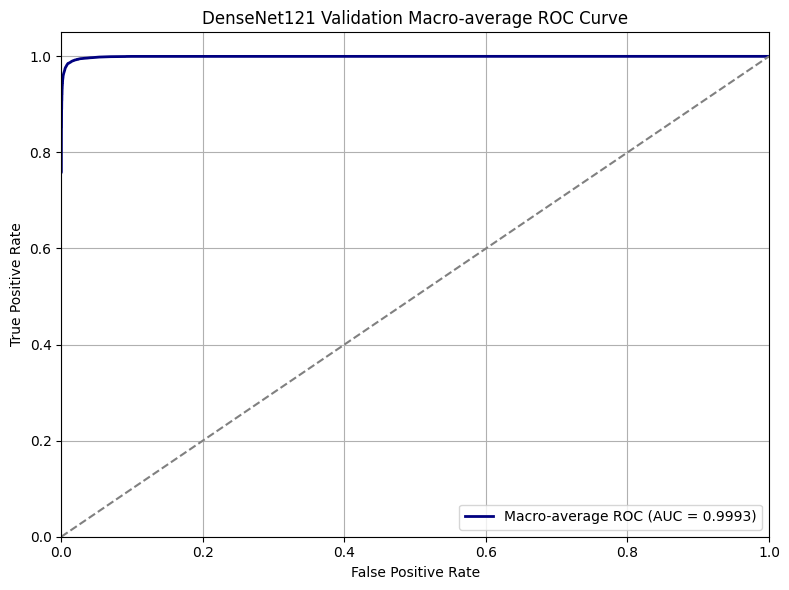

Plotting Confusion matrix:


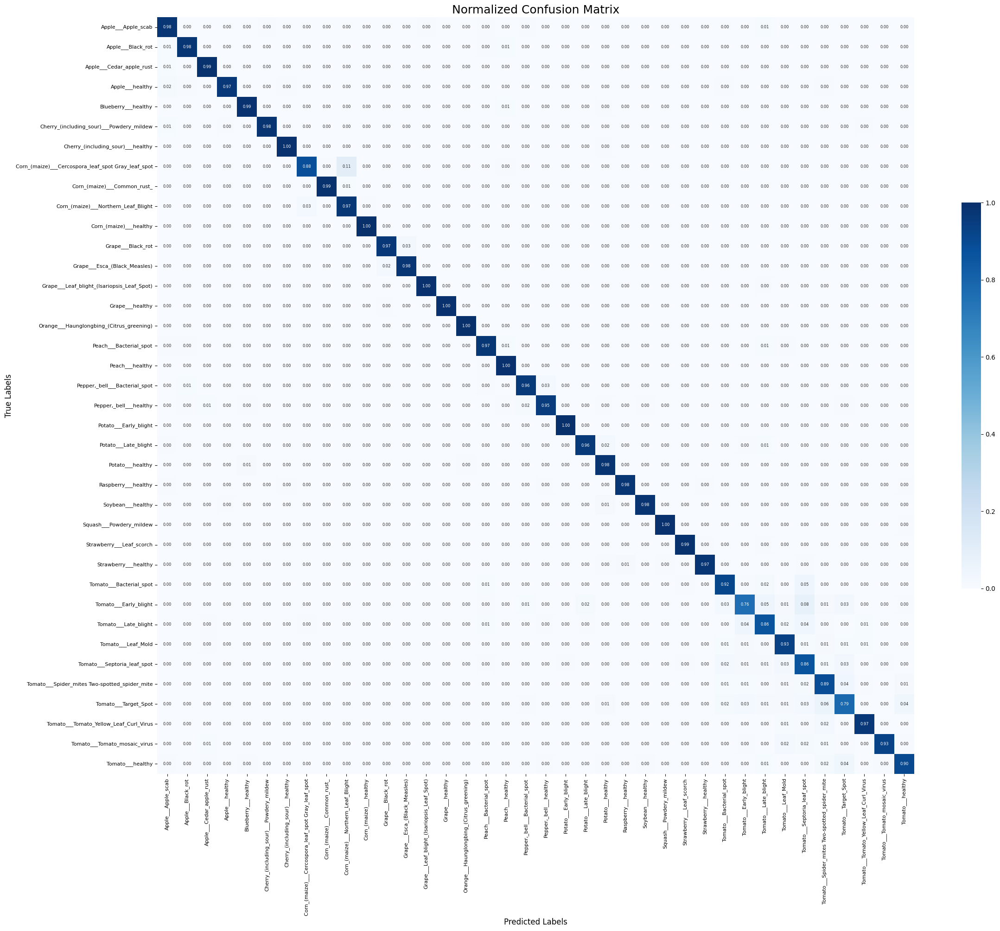

In [25]:
eval_mdl(y_true = val_y_true, y_pred = val_y_pred, y_prob = val_y_probs,class_names = val_class_names,label = "DenseNet121 Validation",normalize = True)

## **DenseNet: Accuracy and Loss Curve**

[INFO] Loading history from: /kaggle/input/densenet/tensorflow2/default/1/dnet_history.json


/tmp/ipykernel_35/1415381371.py:53: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



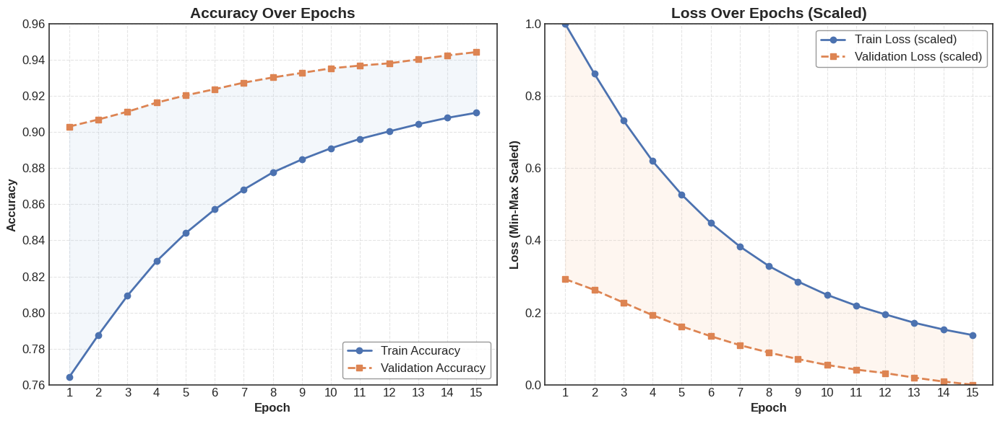

In [26]:
plt_acc_and_lss_crvs(hisx=config.dnet_hisx)

## **DenseNet: Testing Evaluation**

In [27]:
tst_y_true = tst_dta.classes  # From generator
tst_y_probs = dnet_mdlx.predict(tst_dta, verbose=1)
tst_y_pred = npx.argmax(tst_y_probs, axis=1)

# Class names (as you already have)
tst_class_names = list(tst_dta.class_indices.keys())

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



275/275 ━━━━━━━━━━━━━━━━━━━━ 157s 572ms/step



DenseNet121 Testing Metrics:
Accuracy            : 0.9557
F1 Score (Weighted) : 0.9556
Precision           : 0.9563
Recall              : 0.9557
Cohen's Kappa       : 0.9545

DenseNet121 Testing Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.92      0.97      0.94       252
                                 Apple___Black_rot       0.99      0.97      0.98       249
                          Apple___Cedar_apple_rust       1.00      0.97      0.98       220
                                   Apple___healthy       0.97      0.96      0.96       251
                               Blueberry___healthy       0.98      0.99      0.98       227
          Cherry_(including_sour)___Powdery_mildew       0.99      0.98      0.99       211
                 Cherry_(including_sour)___healthy       0.99      1.00      0.99       228
Corn_(maize)___Cercospora_leaf_spot Gray_le

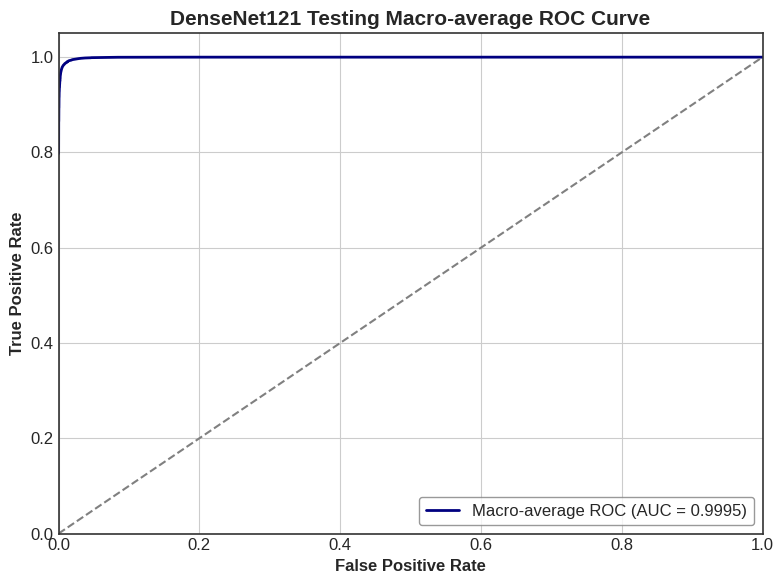

Plotting Confusion matrix:


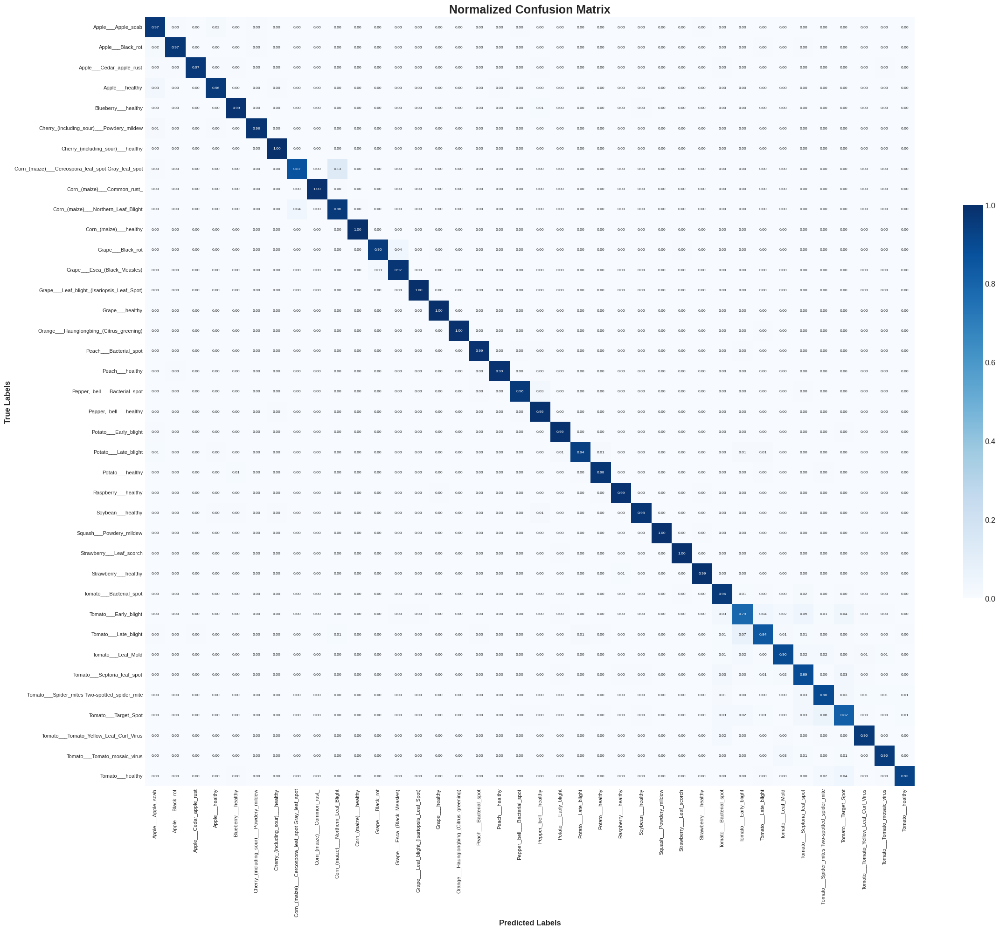

In [28]:
eval_mdl(y_true = tst_y_true, y_pred = tst_y_pred, y_prob = tst_y_probs,class_names = tst_class_names,label = "DenseNet121 Testing",normalize = True)

## **DenseNet: Inference**

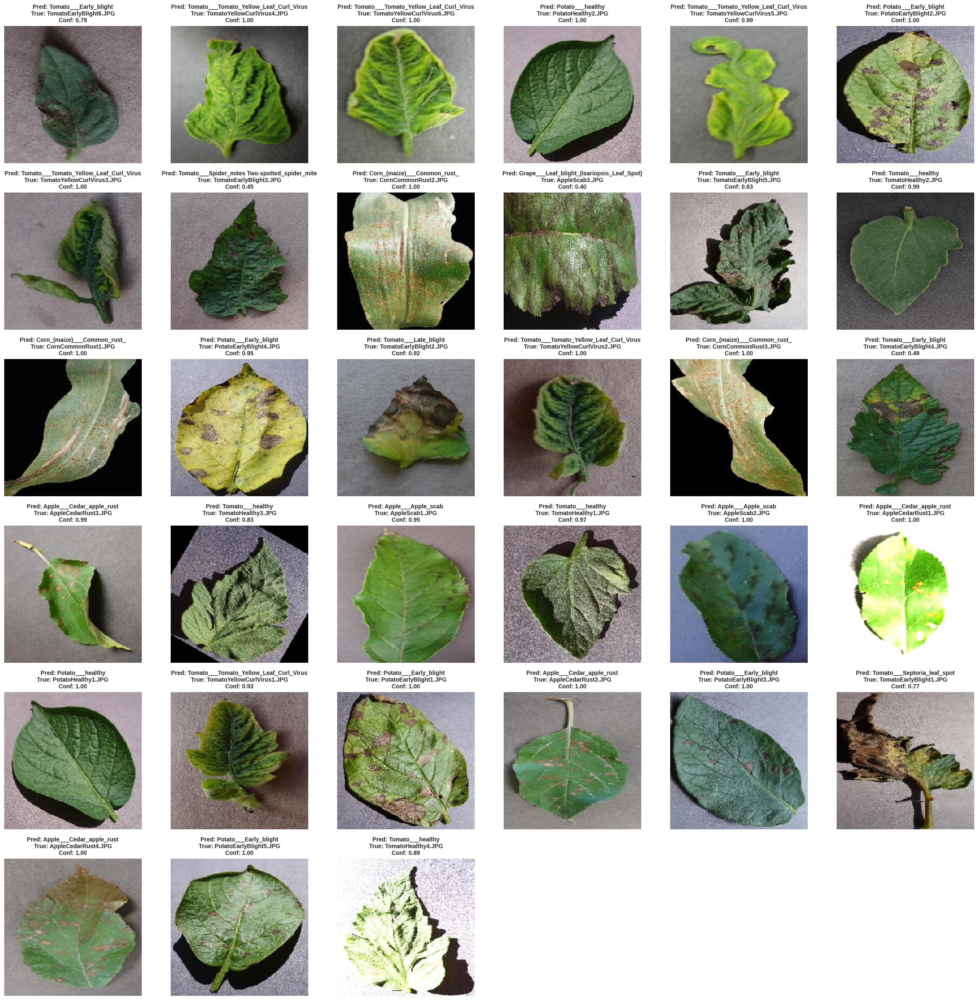

In [29]:
img_list = get_all_images_from_folder(config.rl_timex_dir)

predict_and_show_images(
    model=dnet_mdlx,
    img_pths=img_list,
    class_indices=tst_dta.class_indices,
    target_size=(224,224)
)


# **ResNet50 Model**

clss wghts for rsnt model

In [30]:
class_weights_array = cmpute_clss_wght(
    class_weight='balanced',
    classes=npx.unique(trn_dta.classes),
    y=trn_dta.classes
)
class_weight = dict(enumerate(class_weights_array))

In [31]:
# Load the base ResNet50 model
input_shpe = (img_sze, img_sze, 3)
resnet = kx.applications.ResNet50(
    weights="imagenet",
    include_top=False,
    input_shape=input_shpe
)

# Unfreeze top 30 layers (deepest layers hold high-level features)
for layer in resnet.layers[-30:]:
    layer.trainable = True

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [32]:
# Define the model structure
inputs = kx.Input(shape=input_shpe)
xx = resnet(inputs, training=True)
xx = tfx.keras.layers.GlobalAveragePooling2D()(xx)
xx = tfx.keras.layers.BatchNormalization()(xx)
xx = tfx.keras.layers.Dense(512)(xx)
xx = tfx.keras.layers.LeakyReLU(alpha=0.1)(xx)
xx = tfx.keras.layers.Dropout(0.5)(xx)
xx = tfx.keras.layers.Dense(len(cts), activation="softmax")(xx)

# Build the model
resnet_mdlx = mdl(inputs=inputs, outputs=xx)

# Summary
resnet_mdlx.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning:

Argument `alpha` is deprecated. Use `negative_slope` instead.



Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50 (Functional)                │ (None, 7, 7, 2048)          │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_1           │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 2048)                │           8,192 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 512)                 │       1,049,088 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 38)                  │          19,494 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 24,664,486 (94.09 MB)

 Trainable params: 24,607,270 (93.87 MB)

 Non-trainable params: 57,216 (223.50 KB)

In [33]:
# Define loss with label smoothing
loss_fn = tfx.keras.losses.CategoricalCrossentropy(label_smoothing=0.1)

# Compile the model
resnet_mdlx.compile(
    optimizer=kx.optimizers.Adam(learning_rate=1e-3),
    loss=loss_fn,
    metrics=["accuracy"]
)

In [34]:
# Callbacks
early_stopping_cb = cbx.EarlyStopping(
    monitor="val_loss", patience=5, restore_best_weights=True
)

lr_plateau_cb = cbx.ReduceLROnPlateau(
    monitor="val_loss", factor=0.8, patience=4, min_lr=1e-6, verbose=1
)

mdl_chk_cb = cbx.ModelCheckpoint(
    "best_resnet_model.h5",
    save_best_only=True,
    monitor="val_loss",
    mode="min",
    verbose=1
)

In [35]:
# Training or Loading
if not config.rsnt_enble_trning:
    print(f"Pretrained model found at {config.rsnt_mdl}. Skipping training.")
    resnet_mdlx = tfx.keras.models.load_model(config.rsnt_mdl)

    # Load training history if available
    if osx.path.exists(config.rsnt_hisx):
        with open(config.rsnt_hisx, 'r') as f:
            history_dict = json.load(f)
        class DummyHistory:
            history = history_dict
        hisx = DummyHistory()
    else:
        print("No saved history found. Curves will be empty.")
        class DummyHistory:
            history = {
                'accuracy': [],
                'val_accuracy': [],
                'loss': [],
                'val_loss': []
            }
        hisx = DummyHistory()
else:
    print("No pretrained model found. Proceeding with training...")
    # Train
    hisx = resnet_mdlx.fit(
        trn_dta,
        epochs=config.epochs,
        batch_size=config.trn_btch_sze,
        validation_data=val_dta,
        callbacks=[early_stopping_cb, lr_plateau_cb, mdl_chk_cb]
    )

    # Save history
    with open(config.rsnt_hisx, 'w') as f:
        json.dump(hisx.history, f)

Pretrained model found at /kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_plant_disease.keras. Skipping training.


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning:

Skipping variable loading for optimizer 'rmsprop', because it has 220 variables whereas the saved optimizer has 438 variables. 



## **ResNet: Save and Load Model**

In [36]:
# Save model
if config.rsnt_enble_trning:
    resnet_mdlx.save(config.rsnt_mdl)
    print(f"Model saved to {config.rsnt_mdl}")
    display(FileLink(config.rsnt_mdl))
else:
    print(f"Model file '{config.rsnt_mdl}' already exists. Skipping save.")

Model file '/kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_plant_disease.keras' already exists. Skipping save.


In [37]:
# Save categories
if config.rsnt_enble_trning:
    with open(config.rsnt_categories, "w") as file:
        json.dump(trn_dta.class_indices, file)
    print(f"Categories dumped to {config.rsnt_categories}")
    display(FileLink(config.rsnt_categories))
else:
    print(f"File '{config.rsnt_categories}' already exists. Skipping category dump.")

File '/kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_categories.json' already exists. Skipping category dump.


## **ResNet: Validating Evaluation** 

In [38]:
val_y_true = val_dta.classes  # From generator
val_y_probs = resnet_mdlx.predict(val_dta, verbose=1)
val_y_pred = npx.argmax(val_y_probs, axis=1)

# Class names (as you already have)
val_class_names = list(val_dta.class_indices.keys())

275/275 ━━━━━━━━━━━━━━━━━━━━ 108s 365ms/step



ResNet Validation Metrics:
Accuracy            : 0.9452
F1 Score (Weighted) : 0.9444
Precision           : 0.9525
Recall              : 0.9452
Cohen's Kappa       : 0.9437

ResNet Validation Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      0.94      0.97       252
                                 Apple___Black_rot       0.99      0.98      0.99       248
                          Apple___Cedar_apple_rust       0.98      1.00      0.99       220
                                   Apple___healthy       0.92      1.00      0.96       251
                               Blueberry___healthy       0.99      0.97      0.98       227
          Cherry_(including_sour)___Powdery_mildew       1.00      0.97      0.99       210
                 Cherry_(including_sour)___healthy       1.00      0.99      1.00       228
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_s

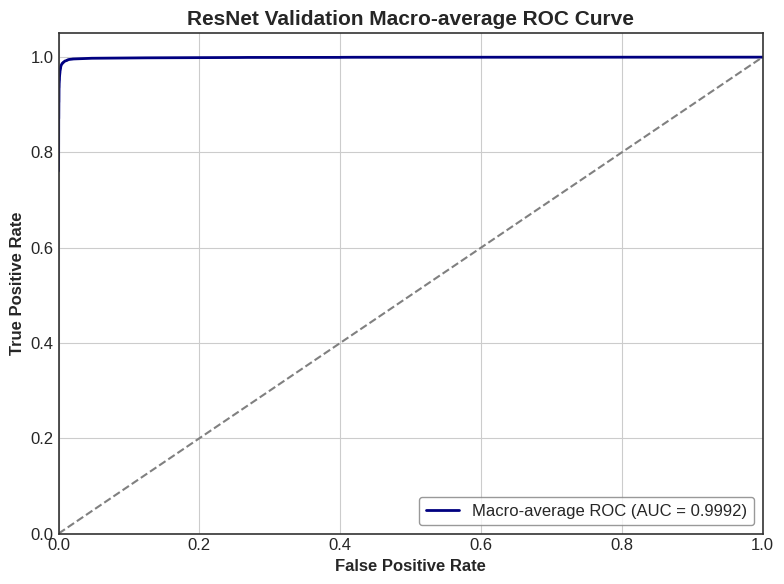

Plotting Confusion matrix:


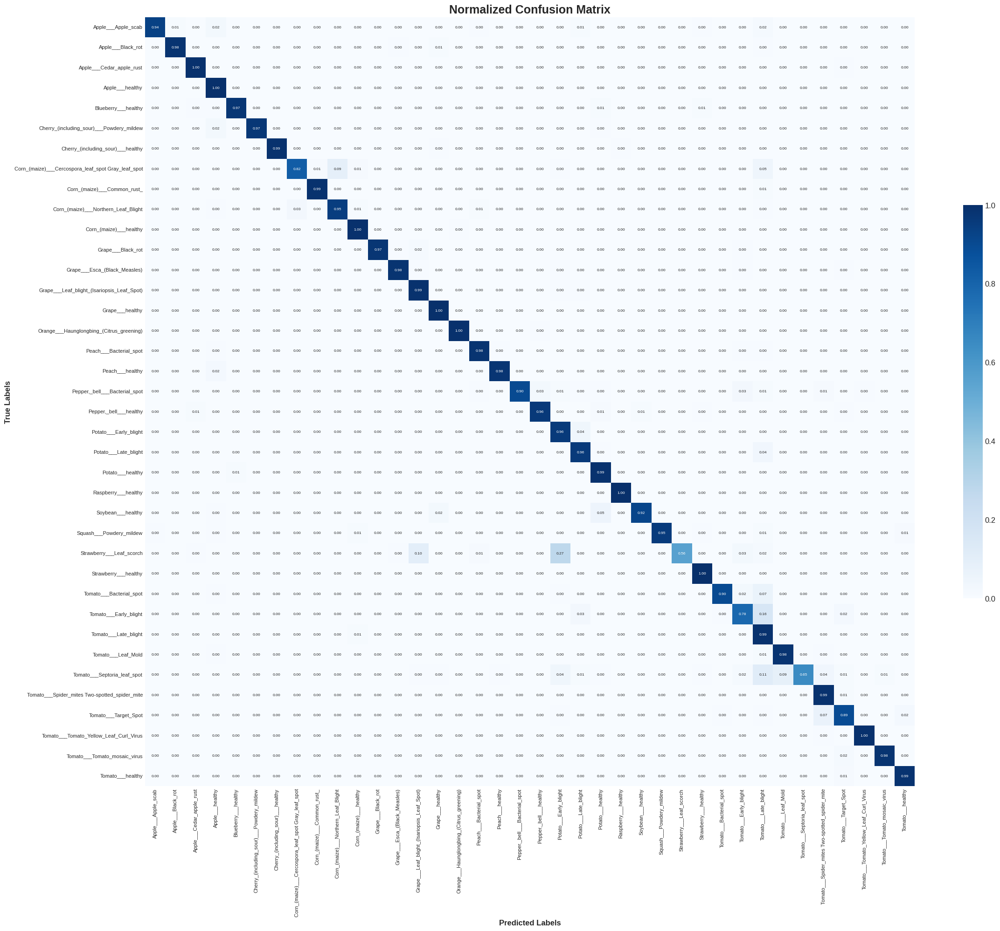

In [39]:
eval_mdl(y_true = val_y_true, y_pred = val_y_pred, y_prob = val_y_probs,class_names = val_class_names,label = "ResNet Validation",normalize = True)

## **ResNet: Accuracy and Loss Curve** 

[INFO] Loading history from: /kaggle/input/leaf_disease_resnet50/tensorflow2/default/1/resnet_history.json


/tmp/ipykernel_35/1415381371.py:53: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



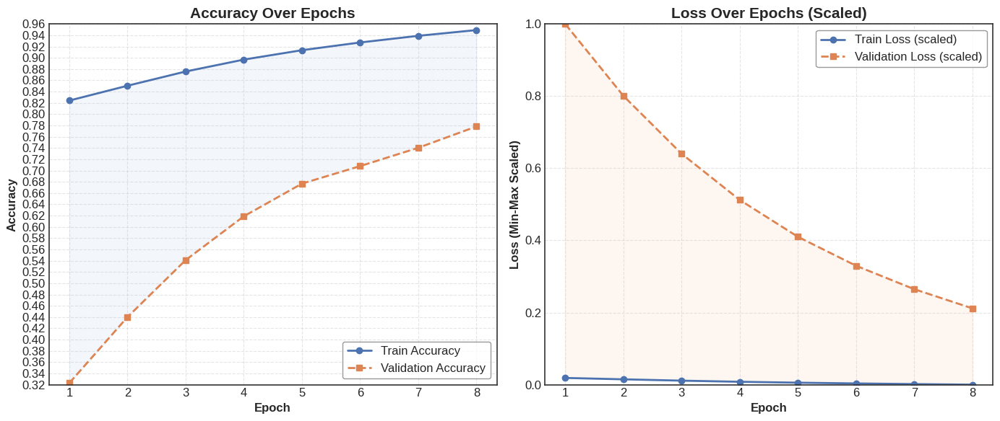

In [40]:
plt_acc_and_lss_crvs(hisx=config.rsnt_hisx)

## **ResNet: Testing Evaluation** 

In [41]:
tst_y_true = tst_dta.classes  # From generator
tst_y_probs = resnet_mdlx.predict(tst_dta, verbose=1)
tst_y_pred = npx.argmax(tst_y_probs, axis=1)

# Class names (as you already have)
tst_class_names = list(tst_dta.class_indices.keys())

275/275 ━━━━━━━━━━━━━━━━━━━━ 100s 363ms/step



ResNet Testing Metrics:
Accuracy            : 0.9449
F1 Score (Weighted) : 0.9438
Precision           : 0.9519
Recall              : 0.9449
Cohen's Kappa       : 0.9434

ResNet Testing Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.99      0.93      0.96       252
                                 Apple___Black_rot       0.99      0.98      0.99       249
                          Apple___Cedar_apple_rust       0.99      1.00      0.99       220
                                   Apple___healthy       0.92      1.00      0.96       251
                               Blueberry___healthy       1.00      0.98      0.99       227
          Cherry_(including_sour)___Powdery_mildew       1.00      0.99      1.00       211
                 Cherry_(including_sour)___healthy       1.00      1.00      1.00       228
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot   

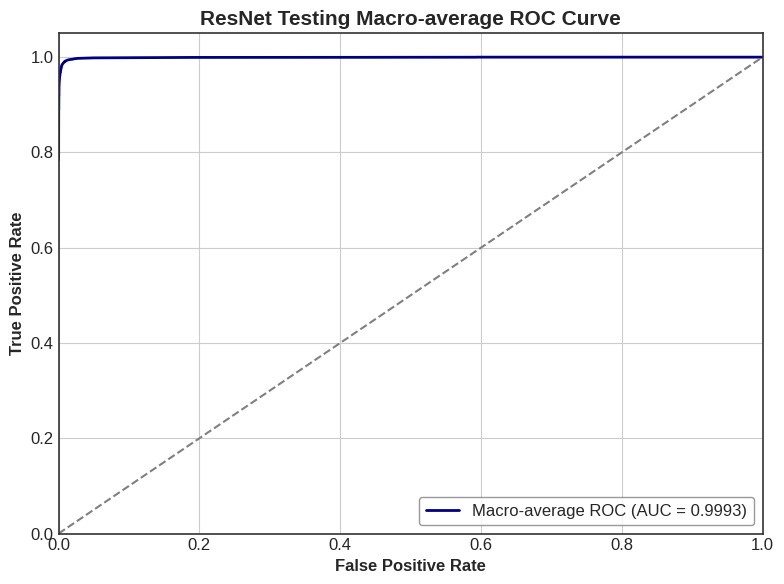

Plotting Confusion matrix:


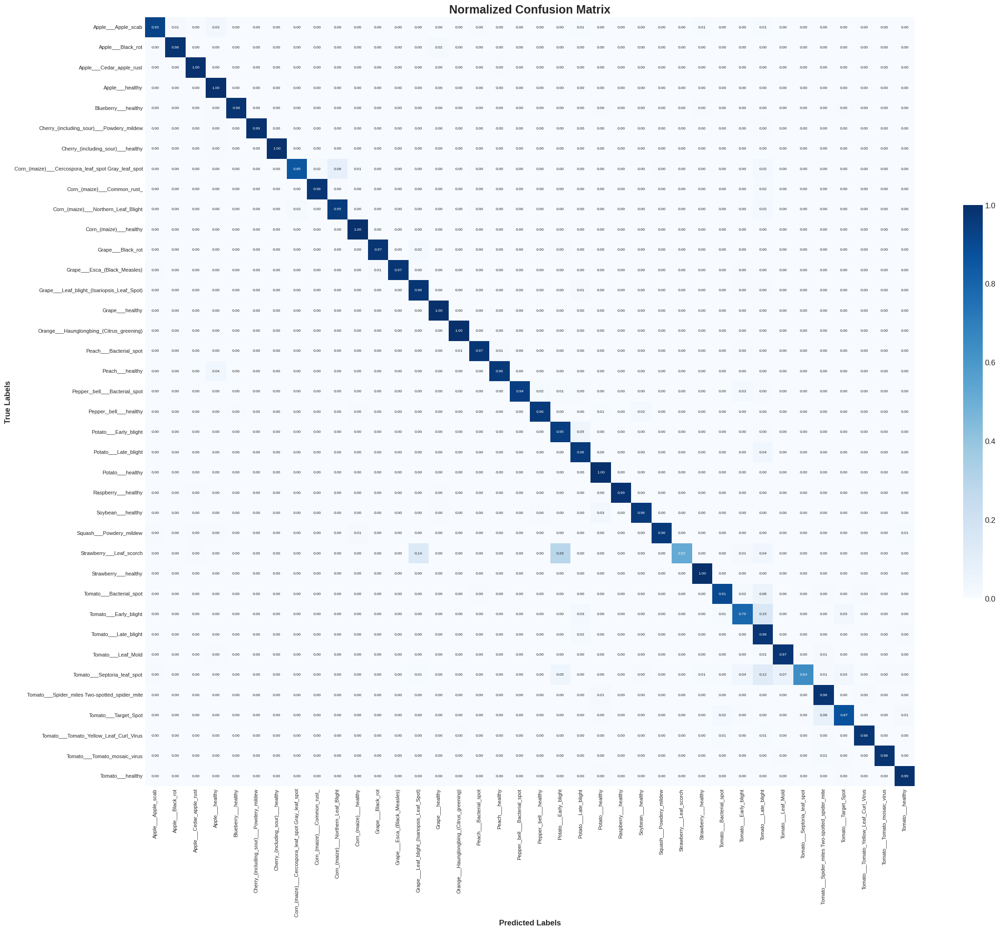

In [42]:
eval_mdl(y_true = tst_y_true, y_pred = tst_y_pred, y_prob = tst_y_probs,class_names = tst_class_names,label = "ResNet Testing",normalize = True)

## **ResNet: Inference** 

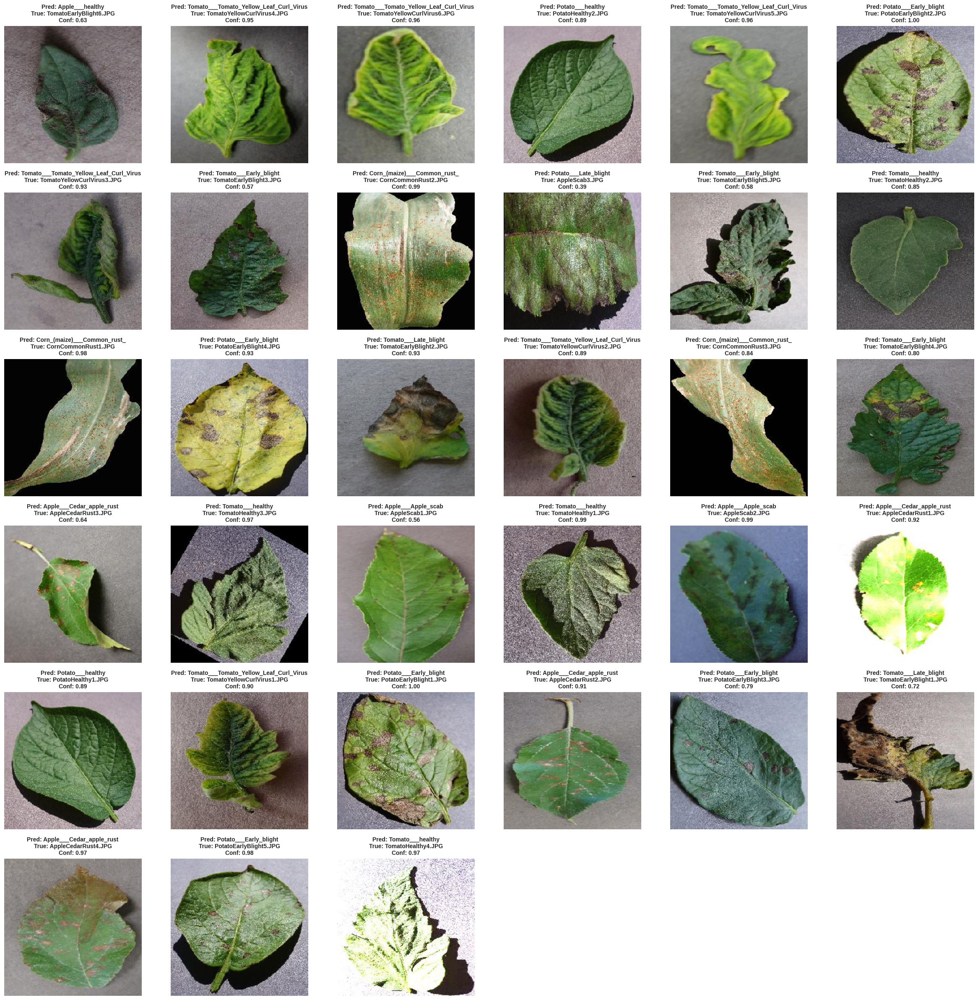

In [43]:
img_list = get_all_images_from_folder(config.rl_timex_dir)

predict_and_show_images(
    model=resnet_mdlx,
    img_pths=img_list,
    class_indices=tst_dta.class_indices,
    target_size=(224,224)
)


# **Hybrid: ResNet+ denseNet Model**

In [44]:
# Note: .classes gives true class indices for all training samples in the generator
class_weights = cmpute_clss_wght(
    class_weight="balanced",
    classes=npx.unique(trn_dta.classes),
    y=trn_dta.classes
)
class_weight = dict(enumerate(class_weights))


In [45]:
# Input shape
input_shpe = (img_sze, img_sze, 3)
inputs = Input(shape=input_shpe)

In [46]:
# Load ResNet50
resnet_base = ResNet50(weights="imagenet", include_top=False, input_shape=input_shpe)
for layer in resnet_base.layers[:-10]:
    layer.trainable = False
resnet_out = resnet_base(inputs)
resnet_out = GlobalAveragePooling2D()(resnet_out)

In [47]:
# Load DenseNet121
densenet_base = DenseNet121(weights="imagenet", include_top=False, input_shape=input_shpe)
for layer in densenet_base.layers[:-10]:
    layer.trainable = False
densenet_out = densenet_base(inputs)
densenet_out = GlobalAveragePooling2D()(densenet_out)

In [48]:
# Merge outputs
print("Concatenating outputs from ResNet50 and DenseNet121...")
concat = concatenate([resnet_out, densenet_out])
xx = BatchNormalization()(concat)
xx = Dense(1024)(xx)
xx = LeakyReLU(alpha=0.1)(xx)
xx = Dropout(0.5)(xx)
xx = Dense(len(cts), activation='softmax')(xx)


Concatenating outputs from ResNet50 and DenseNet121...


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning:

Argument `alpha` is deprecated. Use `negative_slope` instead.



In [49]:
# Build model
hybrid_model = mdl(inputs=inputs, outputs=xx)
print("Hybrid model created:")
hybrid_model.summary()

Hybrid model created:


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ resnet50 (Functional)     │ (None, 7, 7, 2048)     │     23,587,712 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ densenet121 (Functional)  │ (None, 7, 7, 1024)     │      7,037,504 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 2048)           │              0 │ resnet50[0][0]         │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d… │ (None, 1024)           │              0 │ densenet121[0][0]      │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 3072)           │              0 │ global_average_poolin… │
│                           │                        │                │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 3072)           │         12,288 │ concatenate[0][0]      │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_3 (Dense)           │ (None, 1024)           │      3,146,752 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_1 (LeakyReLU) │ (None, 1024)           │              0 │ dense_3[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 1024)           │              0 │ leaky_re_lu_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_4 (Dense)           │ (None, 38)             │         38,950 │ dropout_2[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 33,823,206 (129.03 MB)

 Trainable params: 7,825,638 (29.85 MB)

 Non-trainable params: 25,997,568 (99.17 MB)

In [50]:
# Compile model
print("Compiling model...")
loss_fn = catcrsstrpy(label_smoothing=0.1)
hybrid_model.compile(
    optimizer=Adam(learning_rate=1e-3),
    loss=loss_fn,
    metrics=["accuracy"]
)

Compiling model...


In [51]:
# Callbacks
early_stopping_cb = esx(monitor="val_loss", patience=5, restore_best_weights=True)
lr_plateau_cb = rlrpx(monitor="val_loss", factor=0.5, patience=2, min_lr=1e-6, verbose=1)
mdl_chk_cb = mcpx(
    config.hybrid_mdl,
    save_best_only=True,
    monitor="val_loss",
    mode="min",
    verbose=1
)


In [52]:
# Train or load
if not config.hybrid_enble_trning:
    print(f"Pretrained model found at `{config.hybrid_mdl}`. Loading model...")
    hybrid_model = tfx.keras.models.load_model(config.hybrid_mdl)
    if osx.path.exists(config.hybrid_historyx):
        with open(config.hybrid_historyx, 'r') as f:
            history_dict = json.load(f)
        class DummyHistory:
            history = history_dict
        hisx = DummyHistory()
        print("Training history loaded.")
    else:
        print("History file not found. Creating dummy history...")
        class DummyHistory:
            history = {'accuracy': [], 'val_accuracy': [], 'loss': [], 'val_loss': []}
        hisx = DummyHistory()
else:
    print("Training hybrid model using generators...")
    hisx = hybrid_model.fit(
        trn_dta,
        validation_data=val_dta,
        epochs=config.hybrid_epochs,
        batch_size=config.trn_btch_sze,
        class_weight=class_weight,
        callbacks=[early_stopping_cb, lr_plateau_cb, mdl_chk_cb]
    )
    with open(config.hybrid_historyx, 'w') as f:
        json.dump(hisx.history, f)
    print("Training history saved.")

# Save model and categories
if config.hybrid_enble_trning:
    hybrid_model.save(config.hybrid_mdl)
    print(f"Model saved to `{config.hybrid_mdl}`")
    display(FileLink(config.hybrid_mdl))

    with open(config.hybrid_categries, "w") as file:
        json.dump(trn_dta.class_indices, file)
    print(f"Class indices saved to `{config.hybrid_categries}`")
    display(FileLink(config.hybrid_categries))
else:
    print("Model already exists. Skipped saving.")


Pretrained model found at `/kaggle/input/leaf_hybird_model/tensorflow2/default/1/hybrid_plant_disease.keras`. Loading model...
Training history loaded.
Model already exists. Skipped saving.


## **Hybrid: Validating Evaluation** 

In [53]:
val_y_true = val_dta.classes  # From generator
val_y_probs = hybrid_model.predict(val_dta, verbose=1)
val_y_pred = npx.argmax(val_y_probs, axis=1)

# Class names (as you already have)
val_class_names = list(val_dta.class_indices.keys())

275/275 ━━━━━━━━━━━━━━━━━━━━ 132s 420ms/step



Hybrid:ResNet+DenseNet Validation Metrics:
Accuracy            : 0.9945
F1 Score (Weighted) : 0.9945
Precision           : 0.9946
Recall              : 0.9945
Cohen's Kappa       : 0.9944

Hybrid:ResNet+DenseNet Validation Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.99      1.00      1.00       252
                                 Apple___Black_rot       1.00      1.00      1.00       248
                          Apple___Cedar_apple_rust       0.99      1.00      1.00       220
                                   Apple___healthy       1.00      1.00      1.00       251
                               Blueberry___healthy       1.00      1.00      1.00       227
          Cherry_(including_sour)___Powdery_mildew       1.00      1.00      1.00       210
                 Cherry_(including_sour)___healthy       1.00      1.00      1.00       228
Corn_(maize)___

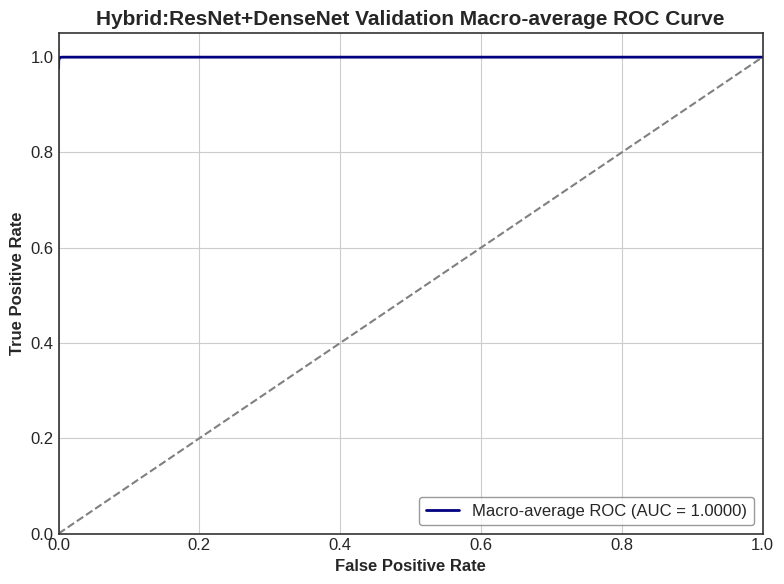

Plotting Confusion matrix:


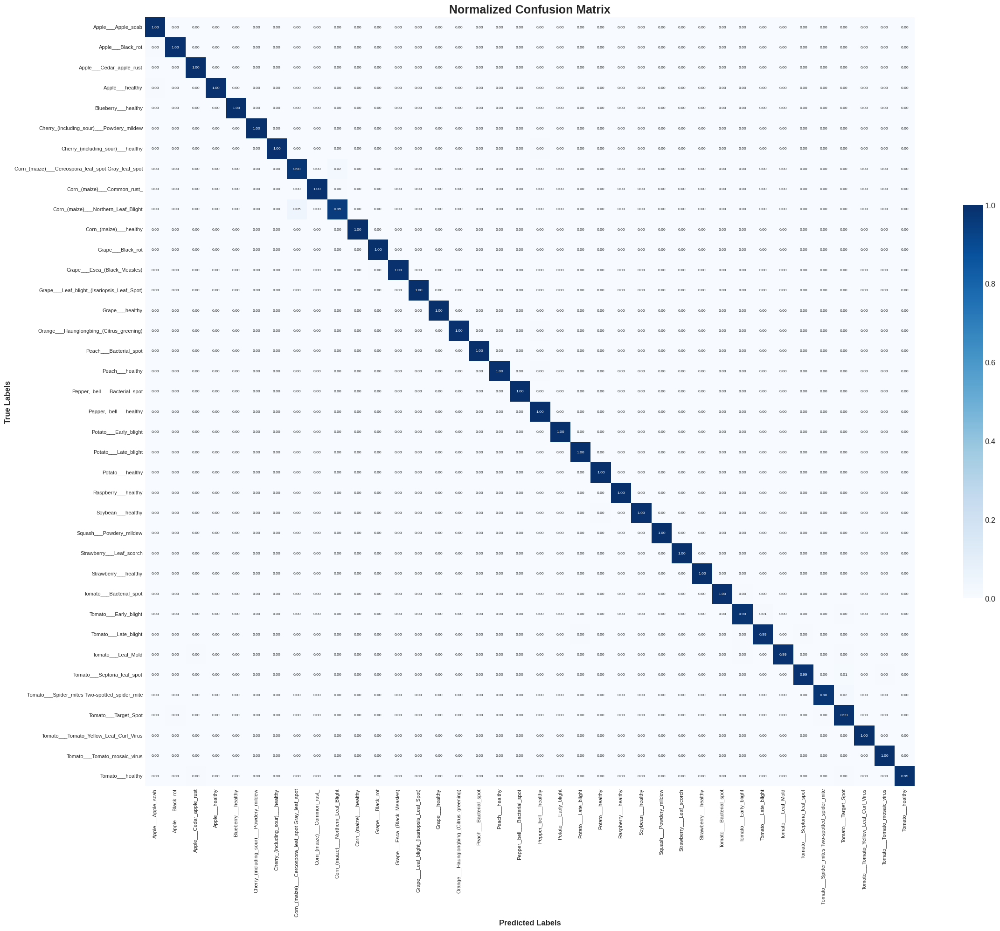

In [54]:
eval_mdl(y_true = val_y_true, y_pred = val_y_pred, y_prob = val_y_probs,class_names = val_class_names,label = "Hybrid:ResNet+DenseNet Validation",normalize = True)

## **Hybrid: Accuracy and Loss Curve**

[INFO] Loading history from: /kaggle/input/leaf_hybird_model/tensorflow2/default/1/hybrid_history.json


/tmp/ipykernel_35/1415381371.py:53: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



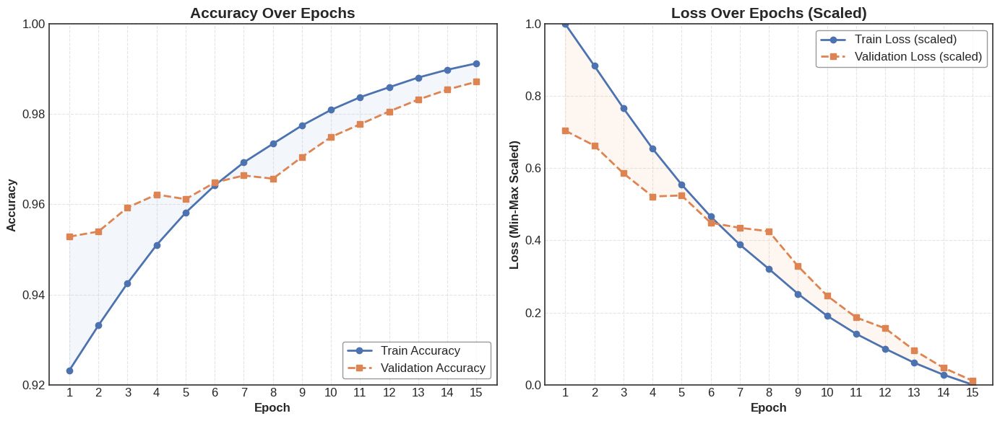

In [55]:
plt_acc_and_lss_crvs(hisx=config.hybrid_historyx)

## **Hybrid: Testing Evaluation**

In [56]:
tst_y_true = tst_dta.classes  # From generator
tst_y_probs = hybrid_model.predict(tst_dta, verbose=1)
tst_y_pred = npx.argmax(tst_y_probs, axis=1)

# Class names (as you already have)
tst_class_names = list(tst_dta.class_indices.keys())

275/275 ━━━━━━━━━━━━━━━━━━━━ 104s 377ms/step



Hybrid:Resnet+DenseNet Testing Metrics:
Accuracy            : 0.9936
F1 Score (Weighted) : 0.9936
Precision           : 0.9938
Recall              : 0.9936
Cohen's Kappa       : 0.9935

Hybrid:Resnet+DenseNet Testing Classification Report:

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      1.00      1.00       252
                                 Apple___Black_rot       1.00      0.99      0.99       249
                          Apple___Cedar_apple_rust       1.00      1.00      1.00       220
                                   Apple___healthy       1.00      1.00      1.00       251
                               Blueberry___healthy       1.00      1.00      1.00       227
          Cherry_(including_sour)___Powdery_mildew       1.00      1.00      1.00       211
                 Cherry_(including_sour)___healthy       1.00      1.00      1.00       228
Corn_(maize)___Cercos

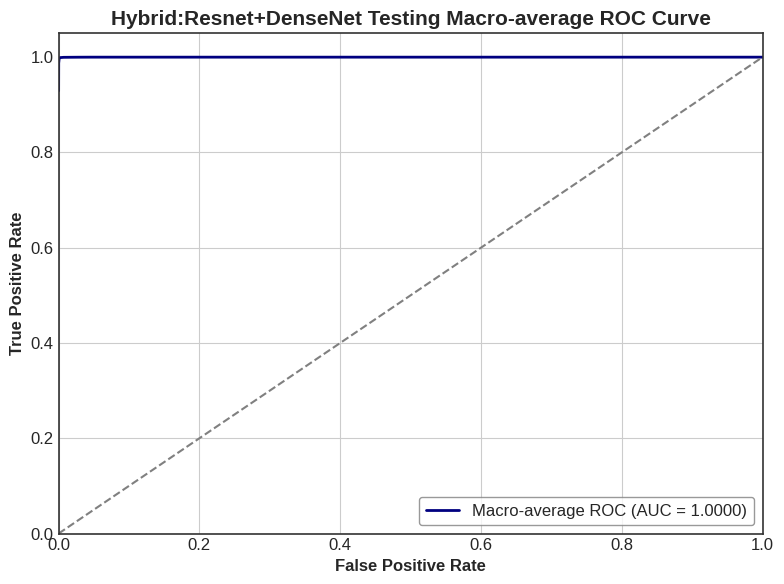

Plotting Confusion matrix:


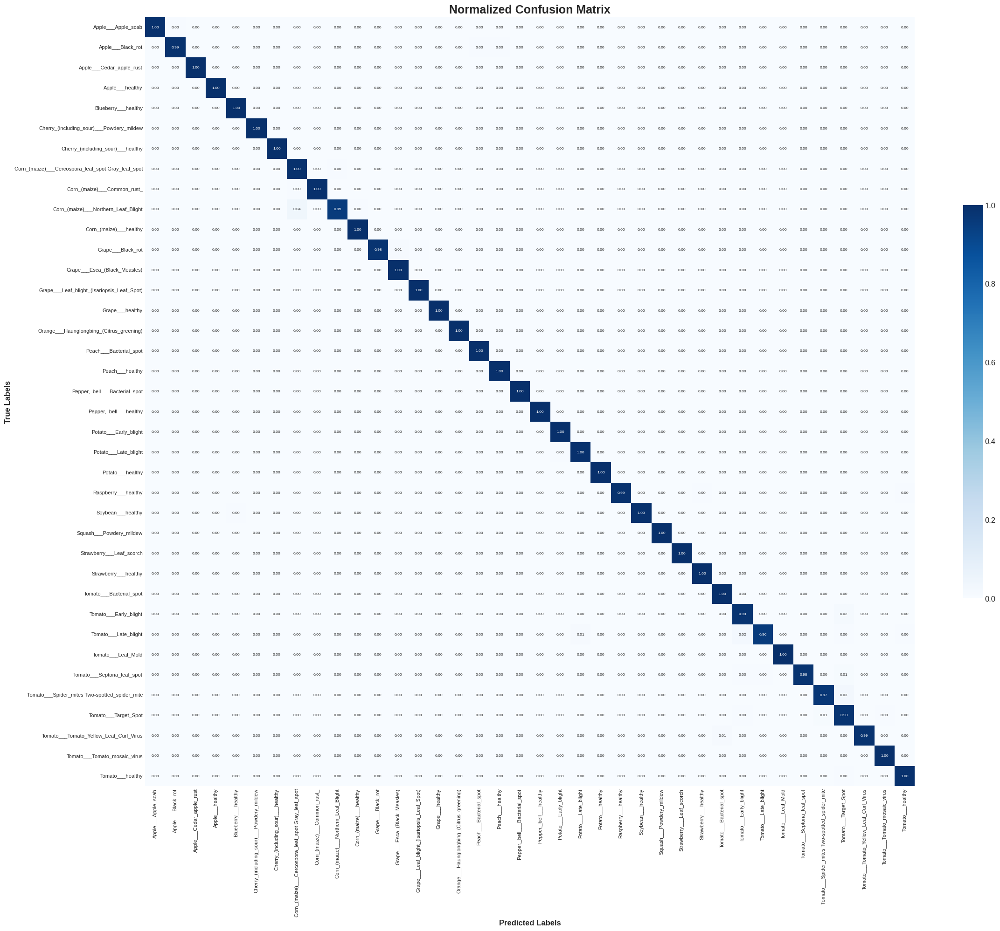

In [57]:
eval_mdl(y_true = tst_y_true, y_pred = tst_y_pred, y_prob = tst_y_probs,class_names = tst_class_names,label = "Hybrid:Resnet+DenseNet Testing",normalize = True)

## **Hybrid: Inference**

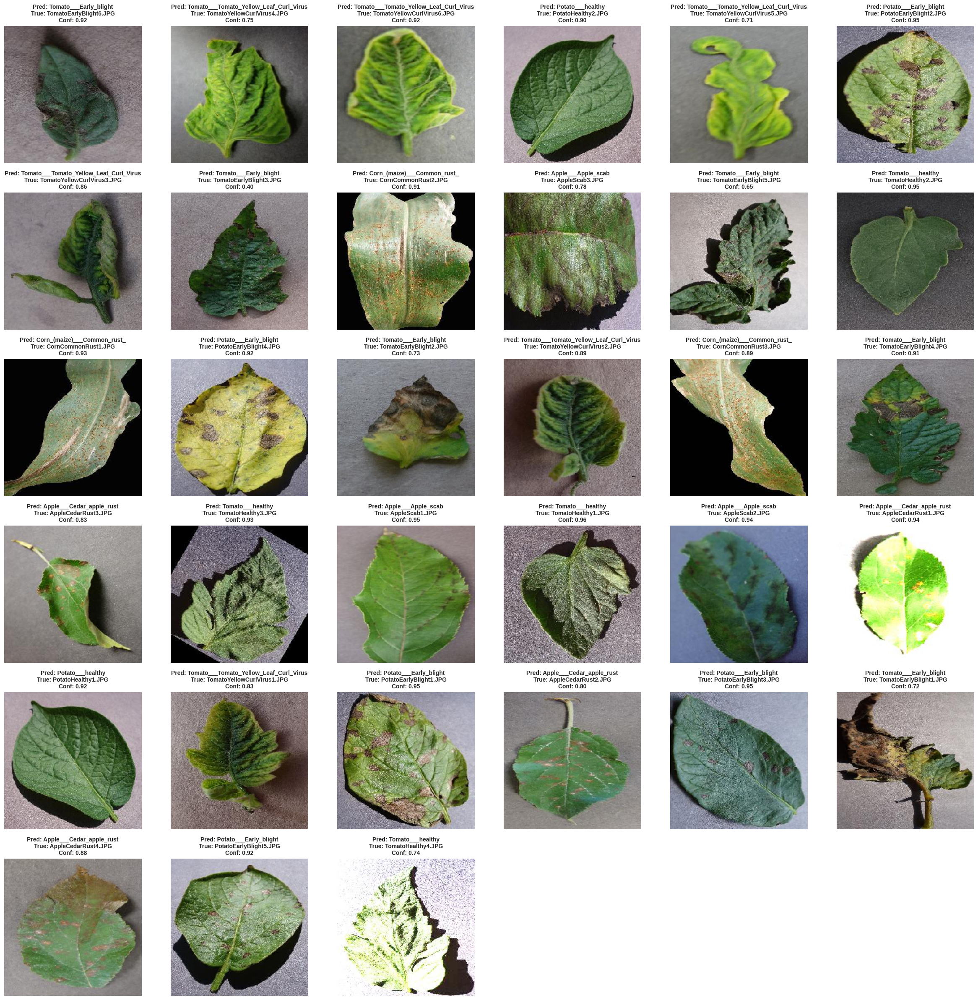

In [58]:
img_list = get_all_images_from_folder(config.rl_timex_dir)

predict_and_show_images(
    model=hybrid_model,
    img_pths=img_list,
    class_indices=tst_dta.class_indices,
    target_size=(224,224)
)


# **Comparative Plots**

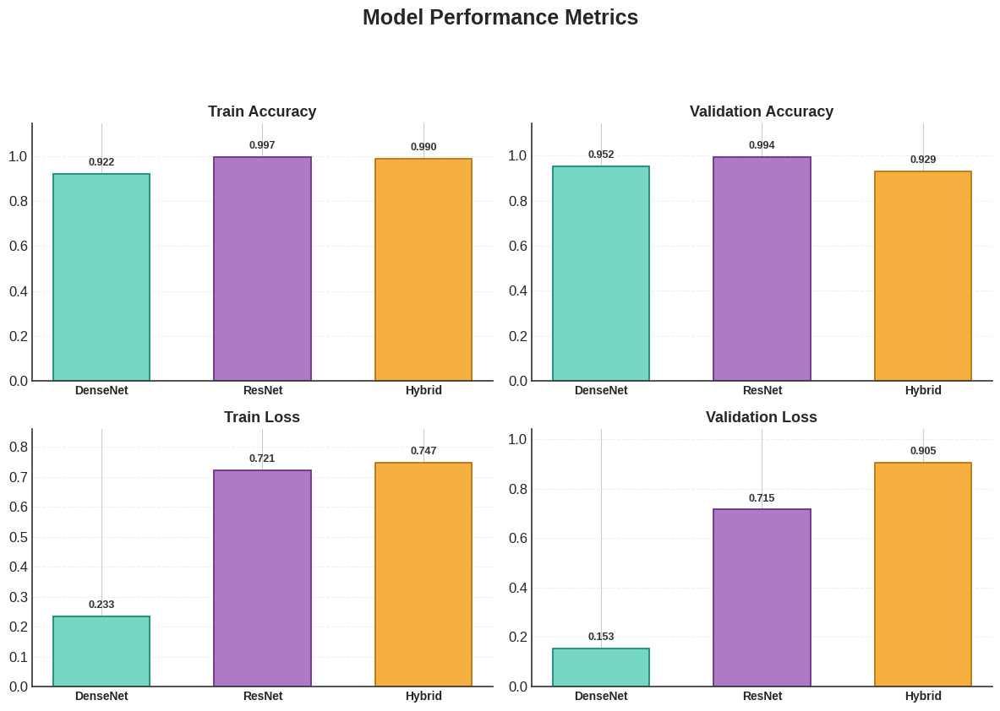

In [59]:
plot_comparative_4panels(config.dnet_hisx,config.rsnt_hisx, config.hybrid_historyx)


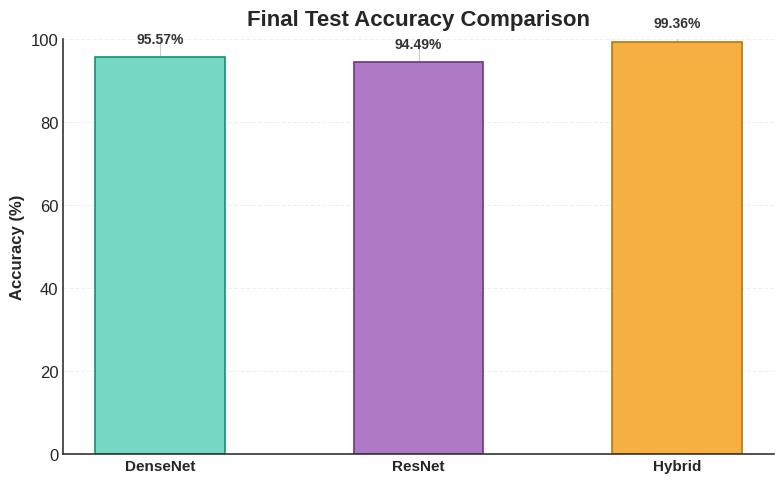

In [71]:
dense_scores = { 'Accuracy': 95.57}
resnet_scores = {  'Accuracy': 94.49}
hybrid_scores = { 'Accuracy': 99.36}

plot_accuracy_comparison(dense_scores, resnet_scores, hybrid_scores)